# Q1

### packages

In [1]:
import torch
import torch.nn.functional as F
from torch import nn
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
from pprint import pprint
from sklearn.manifold import TSNE
from tqdm import trange

In [2]:
torch.__version__

'2.1.0.post100'

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
device

device(type='cpu')

### loading the shakespear data

In [5]:
data = open('input.txt', 'r').readlines()
len(data)

40000

In [6]:
for i in range(len(data)):
    data[i] = data[i].strip("\n").lower()   
# remove all elements in data which are empty strings
data = list(filter(None, data))
len(data)

32777

In [7]:
data[:10]

['first citizen:',
 'before we proceed any further, hear me speak.',
 'all:',
 'speak, speak.',
 'first citizen:',
 'you are all resolved rather to die than to famish?',
 'all:',
 'resolved. resolved.',
 'first citizen:',
 'first, you know caius marcius is chief enemy to the people.']

In [8]:
words = []
for name in data:
    for word in name.split():
        words.append(word)
len(words)

202651

In [9]:
words[:10]

['first',
 'citizen:',
 'before',
 'we',
 'proceed',
 'any',
 'further,',
 'hear',
 'me',
 'speak.']

### Voacbulary

In [10]:
unique_chars = list(set(''.join(data)))
unique_chars.sort()
vocab_dict = {i:ch for i, ch in enumerate(unique_chars)}
vocab_dict_inv = {ch:i for i, ch in enumerate(unique_chars)}
vocab_dict, vocab_dict_inv

({0: ' ',
  1: '!',
  2: '$',
  3: '&',
  4: "'",
  5: ',',
  6: '-',
  7: '.',
  8: '3',
  9: ':',
  10: ';',
  11: '?',
  12: 'a',
  13: 'b',
  14: 'c',
  15: 'd',
  16: 'e',
  17: 'f',
  18: 'g',
  19: 'h',
  20: 'i',
  21: 'j',
  22: 'k',
  23: 'l',
  24: 'm',
  25: 'n',
  26: 'o',
  27: 'p',
  28: 'q',
  29: 'r',
  30: 's',
  31: 't',
  32: 'u',
  33: 'v',
  34: 'w',
  35: 'x',
  36: 'y',
  37: 'z'},
 {' ': 0,
  '!': 1,
  '$': 2,
  '&': 3,
  "'": 4,
  ',': 5,
  '-': 6,
  '.': 7,
  '3': 8,
  ':': 9,
  ';': 10,
  '?': 11,
  'a': 12,
  'b': 13,
  'c': 14,
  'd': 15,
  'e': 16,
  'f': 17,
  'g': 18,
  'h': 19,
  'i': 20,
  'j': 21,
  'k': 22,
  'l': 23,
  'm': 24,
  'n': 25,
  'o': 26,
  'p': 27,
  'q': 28,
  'r': 29,
  's': 30,
  't': 31,
  'u': 32,
  'v': 33,
  'w': 34,
  'x': 35,
  'y': 36,
  'z': 37})

### Generating training set

In [11]:
block_size = 8 # context length: how many characters do we take to predict the next one?
X, Y = [], []
for w in words[:]:
  context = [0] * block_size
  for ch in w + ' ':
    ix = vocab_dict_inv[ch]
    X.append(context)
    Y.append(ix)
    print(''.join(vocab_dict[i] for i in context), '--->', vocab_dict[ix])
    context = context[1:] + [ix] # crop and append
X = torch.tensor(X)
Y = torch.tensor(Y)


         ---> f
       f ---> i
      fi ---> r
     fir ---> s
    firs ---> t
   first --->  
         ---> c
       c ---> i
      ci ---> t
     cit ---> i
    citi ---> z
   citiz ---> e
  citize ---> n
 citizen ---> :
citizen: --->  
         ---> b
       b ---> e
      be ---> f
     bef ---> o
    befo ---> r
   befor ---> e
  before --->  
         ---> w
       w ---> e
      we --->  
         ---> p
       p ---> r
      pr ---> o
     pro ---> c
    proc ---> e
   proce ---> e
  procee ---> d
 proceed --->  
         ---> a
       a ---> n
      an ---> y
     any --->  
         ---> f
       f ---> u
      fu ---> r
     fur ---> t
    furt ---> h
   furth ---> e
  furthe ---> r
 further ---> ,
further, --->  
         ---> h
       h ---> e
      he ---> a
     hea ---> r
    hear --->  
         ---> m
       m ---> e
      me --->  
         ---> s
       s ---> p
      sp ---> e
     spe ---> a
    spea ---> k
   speak ---> .
  speak. --->  
         ---> a
       a

In [12]:
X.shape, X.dtype, Y.shape, Y.dtype

(torch.Size([1108153, 8]), torch.int64, torch.Size([1108153]), torch.int64)

### embeding

In [13]:
# Embedding layer for the context

emb_dim = 4
emb = torch.nn.Embedding(len(vocab_dict), emb_dim)

In [14]:
emb.weight

Parameter containing:
tensor([[ 0.6999,  0.6773,  0.5309, -0.2346],
        [ 2.1482,  0.4742, -0.9305, -0.0060],
        [-0.5129,  0.0352, -0.5614, -0.4641],
        [-0.3355, -0.2976,  2.1192,  0.7649],
        [-0.7507, -0.7472,  0.4305, -0.5133],
        [-0.1280,  0.3511,  0.9986,  0.3709],
        [ 0.1379, -1.4605,  0.7281,  1.3970],
        [-0.1293, -0.3983, -0.6353, -1.4399],
        [ 2.0798, -0.5358,  0.4251,  0.5181],
        [-0.8385,  0.4196, -0.0436, -0.8633],
        [ 2.3658, -0.8166, -1.2448, -0.4495],
        [ 0.3766,  0.3469, -0.6272, -0.7446],
        [-0.0835, -1.4941, -1.1997,  1.1702],
        [ 1.0894, -0.6878,  0.7786,  1.3485],
        [ 0.8128,  0.2709,  0.6522, -1.5397],
        [-0.1453,  0.4506,  0.2942,  0.2697],
        [-1.3870, -1.4502, -0.0844, -0.2723],
        [ 2.0263, -0.1625, -0.3631,  0.1580],
        [-1.2621, -0.2121, -0.2364,  0.4647],
        [-0.6823,  1.2777, -0.6883, -0.0514],
        [ 0.6247,  1.4308,  0.9468, -1.4873],
        [-1.

In [15]:
emb.weight.shape

torch.Size([38, 4])

### embeding visulaization using t-SNE

<Axes: >

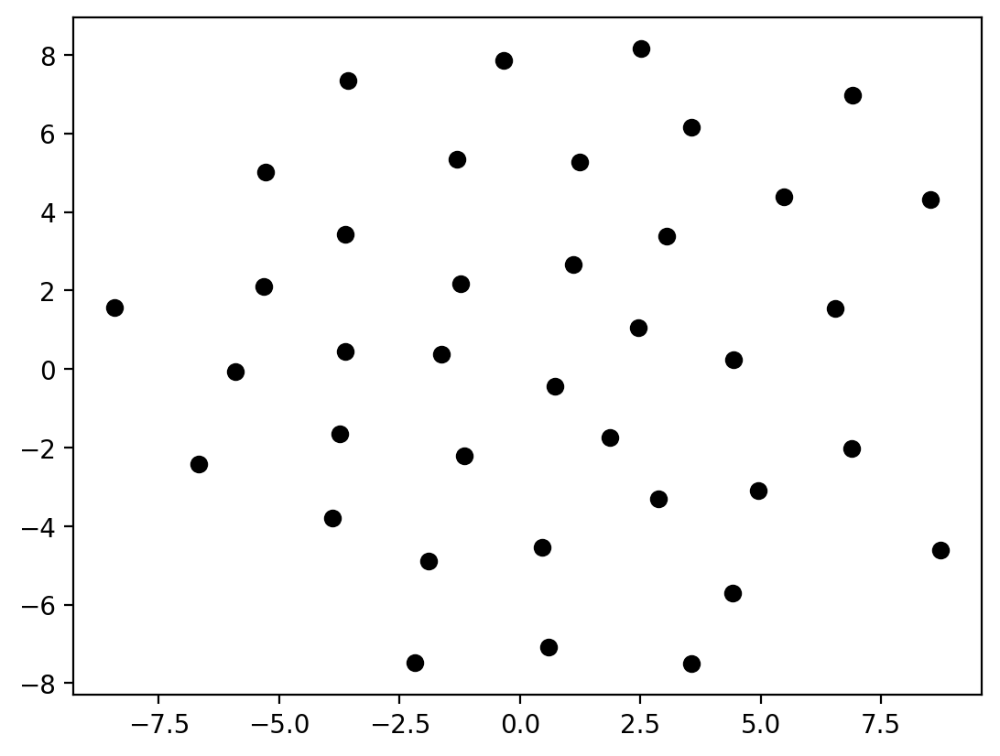

In [16]:
# Function to visualize the embedding in 2d space

# use t-sne to plot the words in 2D space


from sklearn.manifold import TSNE


# Assuming you have a tensor of higher-dimensional embeddings
embeddings = emb.weight.data

# Convert to NumPy array
embeddings_np = embeddings.detach().numpy()

# Apply t-SNE
tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
embeddings_tsne = tsne.fit_transform(embeddings_np)
embeddings_tsne
# convert the embeddings_tsne to a dataframe
df = pd.DataFrame(embeddings_tsne, columns=['1', '2'])




#Function to visualize the embedding in 2d space
# solve the key error 38



def plot_emb(embeddings_tsne, itos, ax=None):
    if ax is None:
        fig, ax = plt.subplots()
    for i in range(len(itos)):
        x = df['1'][i]
        y = df['2'][i]
        ax.scatter(x, y, color='k')
        ax.text(x+ 0.04, y + 0.04, itos[i+1])
    return ax

plot_emb(emb, vocab_dict, ax=None)




### Next character module

In [18]:
class NextChar(nn.Module):
  def __init__(self, block_size, vocab_size, emb_dim, hidden_dims = [block_size * emb_dim, block_size * emb_dim]):
    super().__init__()
    self.emb = nn.Embedding(vocab_size, emb_dim)
    self.lin1 = nn.Linear(block_size * emb_dim, hidden_dims[0])
    self.lin2 = nn.Linear(hidden_dims[0], hidden_dims[1])
    self.lin3 = nn.Linear(hidden_dims[1], vocab_size)

  def forward(self, x):
    x = self.emb(x)
    x = x.view(x.shape[0], -1)
    x = torch.relu(self.lin1(x))
    x = torch.relu(self.lin2(x))
    x = self.lin3(x)
    x = F.log_softmax(x, dim=1)
    return x
    

### Generating K characters without training

In [19]:
model = NextChar(block_size, len(vocab_dict), emb_dim).to(device)
# model = torch.compile(model)

g = torch.Generator()
g.manual_seed(4000002)
def generate_name(model,sentence, itos, stoi, block_size,k):
    original_sentence = sentence
    if len(sentence) < block_size:
        sentence = " " * (block_size - len(sentence)) + sentence
    using_for_predicction = sentence[-block_size:].lower()
    context = [stoi[word] for word in using_for_predicction]
    prediction = ""
    for i in range(k):
        x = torch.tensor(context).view(1, -1).to(device)
        y_pred = model(x)
        # ix = torch.distributions.categorical.Categorical(logits=y_pred).sample().item()
        ix = torch.multinomial(torch.exp(y_pred), 1, generator=g).item()
        ch = itos[ix]
        prediction += ch
        context = context[1:] + [ix]

    return original_sentence + prediction

In [20]:
# for i in range(10):
#     want = input("Do you want to generate text? (yes/no): ")
#     if want == "no":
#         break
#     sentence = input("Enter a sentence: ")
#     print(generate_name(model,sentence, vocab_dict, vocab_dict_inv, block_size))

### parameters without training

In [21]:
for param_name, param in model.named_parameters():
    print(param_name, param.shape)

emb.weight torch.Size([38, 4])
lin1.weight torch.Size([32, 32])
lin1.bias torch.Size([32])
lin2.weight torch.Size([32, 32])
lin2.bias torch.Size([32])
lin3.weight torch.Size([38, 32])
lin3.bias torch.Size([38])


### training the model

In [ ]:
loss_fn = torch.nn.CrossEntropyLoss()
opt = torch.optim.Adam(model.parameters(), lr=0.01)
import time
# Mini-batch training
batch_size = 100000
print_every = 100
elapsed_time = []

In [35]:
# Train the model

for epoch in trange(200):
    start_time = time.time()
    for i in range(0, X.shape[0], batch_size):
        # random shuffle the indices
        idx = torch.randperm(X.shape[0])[:batch_size]
        x = X[idx]
        y = Y[idx]
        y_pred = model(x)
        loss = loss_fn(y_pred, y)
        loss.backward()
        opt.step()
        opt.zero_grad()
    end_time = time.time()
    elapsed_time.append(end_time - start_time)
    if epoch % print_every == 0:
        print(epoch, loss.item())

  0%|          | 1/200 [00:05<16:40,  5.03s/it]

0 1.8906500339508057


 50%|█████     | 101/200 [07:30<06:43,  4.07s/it]

100 1.885041356086731


100%|██████████| 200/200 [14:29<00:00,  4.35s/it]


### TSNE visualization of the embeding

<Axes: >

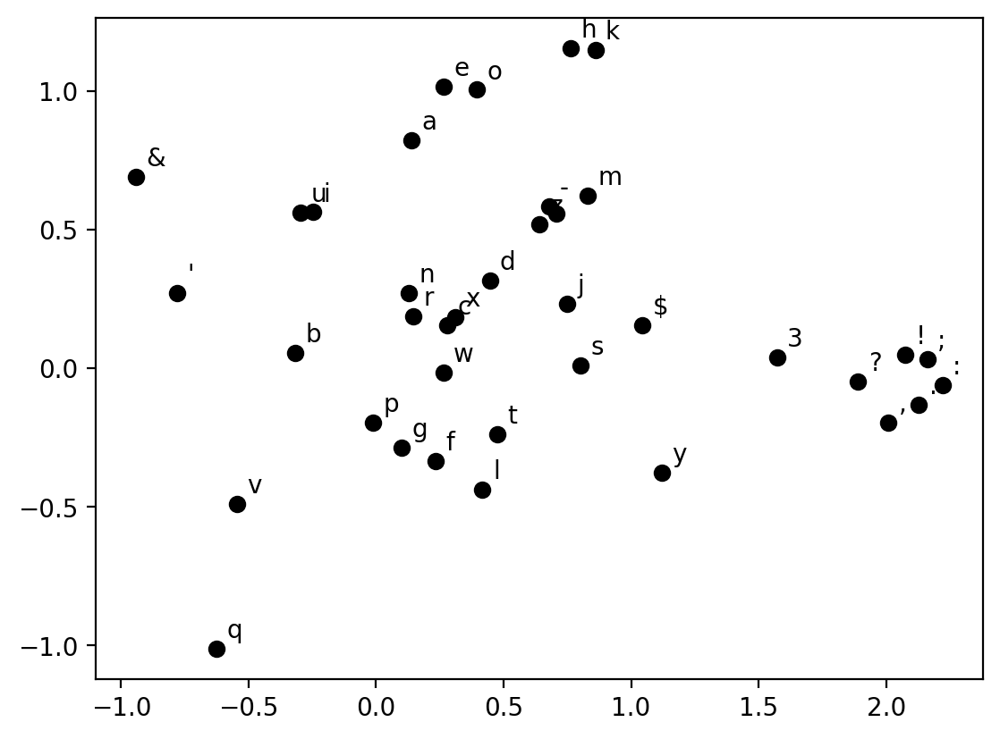

In [36]:
# Function to visualize the embedding in 2d space

# use t-sne to plot the words in 2D space


from sklearn.manifold import TSNE


# Assuming you have a tensor of higher-dimensional embeddings
emb = model.emb
embeddings = emb.weight.data

# Convert to NumPy array
embeddings_np = embeddings.detach().numpy()

# Apply t-SNE
tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
embeddings_tsne = tsne.fit_transform(embeddings_np)
embeddings_tsne
# convert the embeddings_tsne to a dataframe
df = pd.DataFrame(embeddings_tsne, columns=['1', '2'])




#Function to visualize the embedding in 2d space

def plot_emb(embeddings_tsne, itos, ax=None):
    if ax is None:
        fig, ax = plt.subplots()
    for i in range(len(itos)):
        x = df['1'][i]
        y = df['2'][i]
        ax.scatter(x, y, color='k')
        ax.text(x+ 0.04, y + 0.04, itos[i])
    return ax

plot_emb(emb, vocab_dict, ax=None)

In [32]:
# for i in range(5):
#     want = input("Do you want to generate text? (yes/no): ")
#     if want == "no":
#         break
#     sentence = input("Enter a sentence: ")
#     print(generate_name(model,sentence, vocab_dict, vocab_dict_inv, block_size,10))

Tuning knobs

1. Embedding size
2. MLP 
3. Context length

In [ ]:
# save the model
torch.save(model, 'model_sigmoid_dim9.pt')